# Import and settings

In [1]:
%load_ext autoreload
%autoreload 2

from time import localtime, strftime
import os, re, gc, joblib
import numpy as np
import numpy_groupies as npg
import pandas as pd

import anndata
import scanpy as sc
import sctk as sk

import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.colors import ListedColormap
import seaborn as sn
import plotnine as pln
from datetime import date

# YYYY-MM-DD
today = date.today()
today = today.strftime("%Y-%m-%d")

In [2]:
np.set_printoptions(linewidth=150)

rcParams["pdf.fonttype"] = 42
rcParams["ps.fonttype"] = 42

sc.settings.verbosity = 0
expr_cmap = sk.expression_colormap()
sk.set_figsize((4, 4))

In [3]:
def timestamp(date_only=True):
    stamp_format = "%Y%m%d" if date_only else "%Y%m%d-%H%M"
    return strftime(stamp_format, localtime())

In [4]:
def get_reaction_consistencies(compass_reaction_penalties, min_range=1e-3):
    """
    Converts the raw penalties outputs of compass into scores per reactions where higher numbers indicate more activity
    """
    df = -np.log(compass_reaction_penalties + 1)
    df = df[df.max(axis=1) - df.min(axis=1) >= min_range]
    df = df - df.min().min()
    return df

# Load data

In [5]:
path='/nfs/team205/heart/compass/'
run='HCAHeartST10317185'
cell_md= pd.read_csv(f'{path}{run}/cell_metadata.csv', index_col = 0)
cell_md

""
AAACACCAATAACTGC-1
AAACCGTTCGTCCAGG-1
AAACTGCTGGCTCCAA-1
AAAGGCTACGGACCAT-1
AAAGGCTCTCGCGCCG-1
...
TTGTGCAGCCACGTCA-1
TTGTGGTAGGAGGGAT-1
TTGTGTATGCCACCAA-1
TTGTGTTTCCCGAAAG-1


In [6]:
# this is a reference file - not specific to each run of Compass
reaction_metadata = pd.read_csv("/home/jovyan/COMPASSResources/reaction_metadata.csv", index_col = 0)
reaction_metadata

,reaction_name,formula,associated_genes,subsystem,EC_number,confidence
reaction_no_direction,,,,,,
10FTHF5GLUtl,"5-glutamyl-10FTHF transport, lysosomal",1.00 * 10-formyltetrahydrofolate-[Glu](5) [c] ...,NaN,"Transport, lysosomal",NaN,2.0
10FTHF5GLUtm,"5-glutamyl-10FTHF transport, mitochondrial",1.00 * 10-formyltetrahydrofolate-[Glu](5) [m] ...,NaN,"Transport, mitochondrial",NaN,2.0
10FTHF6GLUtl,"6-glutamyl-10FTHF transport, lysosomal",1.00 * 10-formyltetrahydrofolate-[Glu](6) [c] ...,NaN,"Transport, lysosomal",NaN,2.0
10FTHF6GLUtm,"6-glutamyl-10FTHF transport, mitochondrial",1.00 * 10-formyltetrahydrofolate-[Glu](6) [m] ...,NaN,"Transport, mitochondrial",NaN,2.0
10FTHF7GLUtl,"7-glutamyl-10FTHF transport, lysosomal",1.00 * 10-formyltetrahydrofolate-[Glu](7) [c] ...,NaN,"Transport, lysosomal",NaN,2.0
...,...,...,...,...,...,...
MAL_Lte,Transport of L-malate,1.00 * (S)-malate(2-) [e] --> 1.00 * (S)-malat...,NaN,"Transport, extracellular",NaN,NaN
OROTGLUt,OROTGLUt,1.00 * L-glutamate(1-) [c] + 1.00 * Orotate [e...,SLC22A7,"Transport, extracellular",NaN,NaN
PNTOte,Transport of (R)-Pantothenate,1.00 * (R)-Pantothenate [e] --> 1.00 * (R)-Pan...,NaN,"Transport, extracellular",NaN,NaN


In [7]:
#Inspect the reactions
rxns=get_reaction_consistencies(pd.read_csv(f'{path}{run}/out/reactions.tsv', sep="\t", index_col=0)).T
rxns.head(3)

,10FTHF5GLUtl_pos,10FTHF5GLUtm_pos,10FTHF6GLUtl_pos,10FTHF6GLUtm_pos,10FTHF7GLUtl_pos,10FTHF7GLUtm_pos,10FTHFtl_neg,10FTHFtm_neg,10FTHFtm_pos,11DOCRTSLtm_pos,...,sink_5hpet(c)_pos,sink_c101coa(c)_neg,sink_c81coa(c)_neg,sink_citr(c)_pos,sink_dd2coa(c)_neg,sink_decdicoa(c)_neg,sink_octdececoa(c)_neg,sink_pre_prot(r)_neg,sink_tetdec2coa(c)_neg,sink_tetdece1coa(c)_neg
AAACACCAATAACTGC-1,3.594017,3.232561,3.359350,3.150168,3.228809,3.098750,3.594017,2.666244,1.844867,0.665699,...,6.979086,2.024623,2.024623,1.714985,2.024623,2.024623,1.695058,7.512456,2.024623,2.024623
AAACCGTTCGTCCAGG-1,3.623986,3.231555,3.397955,3.148663,3.271436,3.096855,3.623986,2.666244,1.834280,0.660073,...,6.977117,2.008584,2.008584,1.707079,2.008584,2.008584,1.652399,7.510085,2.008584,2.008584
AAACTGCTGGCTCCAA-1,3.612903,3.240935,3.383541,3.161257,3.255526,3.111422,3.612903,2.823577,1.874197,0.672323,...,6.997160,2.091553,2.091553,1.787448,2.091553,2.091553,1.735643,7.546037,2.091553,2.091553


In [8]:
#pos_list = [col for col in rxns.columns if col.endswith('_pos')]
#rxns=rxns[pos_list]

<AxesSubplot:>

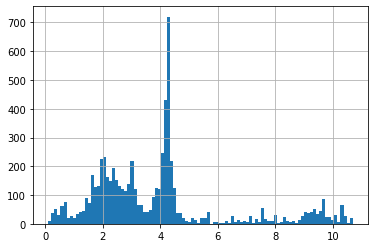

In [9]:
rxns.mean().hist(bins=100)

<AxesSubplot:>

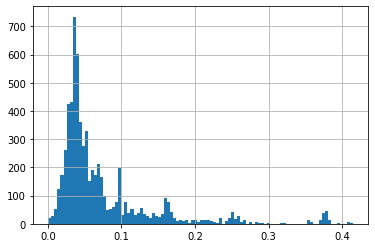

In [10]:
rxns.std().hist(bins=100)

There is very little variability in reactions across cell states

In [11]:
# read in reaction penalties, convert to consistencies, and transpose for scanpy
compass_ad = anndata.AnnData(rxns)

/tmp/ipykernel_23848/86471206.py:2: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.


In [12]:
# get reaction ID column
compass_ad.var['metadata_r_id'] = ""
for r in compass_ad.var.index:
    if r in reaction_metadata.index:
        compass_ad.var.loc[r, 'metadata_r_id'] = r
    elif r[:-4] in reaction_metadata.index:
        compass_ad.var.loc[r, 'metadata_r_id'] = r[:-4]
    else:
        print("Should not occur")

In [13]:
compass_ad.var=compass_ad.var.merge(reaction_metadata, how='left',
                         left_on='metadata_r_id', right_index=True, validate='m:1')

<AxesSubplot:>

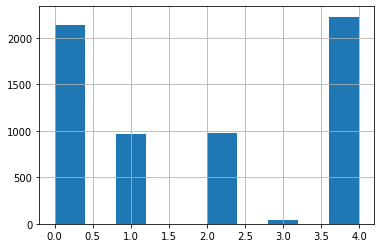

In [14]:
compass_ad.var['confidence'].hist()

In [15]:
# remove reactions with confidences that are not 0 or 4
print(compass_ad.shape)
compass_ad=compass_ad[:,compass_ad.var['confidence'].isin([0,4])]
print(compass_ad.shape)

(830, 6482)
(830, 4366)


In [16]:
compass_ad.write(f'{path}{run}/compass.anndata_converted.{today}.h5ad')

/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.


# Process

## QC

Distribution seems very different from nUMI

Let's take a closer look

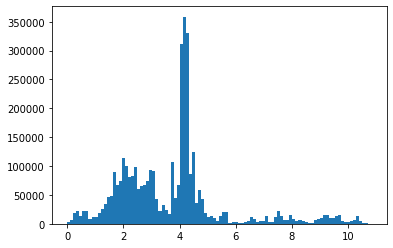

In [17]:
plt.hist(compass_ad.X.flatten(), 100);

Distribution very multi-modal

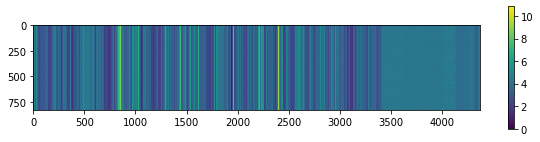

In [18]:
sk.set_figsize((10, 3))
plt.imshow(compass_ad.X)
plt.colorbar(shrink=0.75);

## Clustering by metabolic state: all clusters

In [19]:
print(compass_ad.X.mean())
print(compass_ad.X.std())

3.7218103
1.9004726


In [20]:
#log normalising
sc.pp.normalize_total(compass_ad, target_sum=1e4)
sc.pp.log1p(compass_ad)
compass_ad.raw = compass_ad

In [21]:
print(compass_ad.X.mean())
print(compass_ad.X.std())

1.1320016
0.34468278


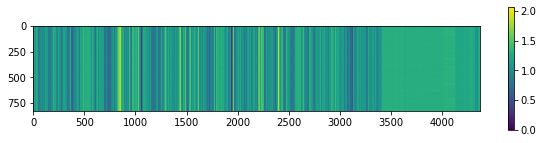

In [22]:
sk.set_figsize((10, 3))
plt.imshow(compass_ad.X)
plt.colorbar(shrink=0.75);

In [23]:
compass_ad.raw.X.sum(axis=1).min(), compass_ad.raw.X.sum(axis=1).max()

(4920.255, 4953.2065)

### highly variable features only

In [24]:
sc.pp.highly_variable_genes(compass_ad)

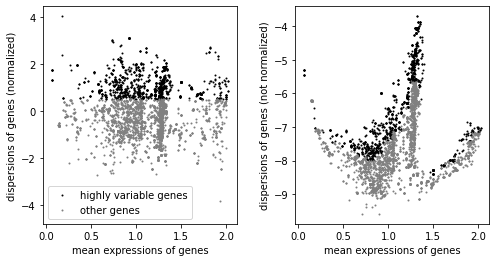

In [25]:
sk.set_figsize((4, 4))
sc.pl.highly_variable_genes(compass_ad)

In [26]:
print(compass_ad.shape)
compass_ad = compass_ad[:, compass_ad.var.highly_variable]
print(compass_ad.shape)

(830, 4366)
(830, 1341)


In [27]:
sc.pp.scale(compass_ad, zero_center=True, max_value=10)

/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.


In [28]:
sc.pp.pca(compass_ad, use_highly_variable=True)
sc.pp.neighbors(compass_ad, n_neighbors=10, n_pcs=14)
sc.tl.umap(compass_ad)

/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


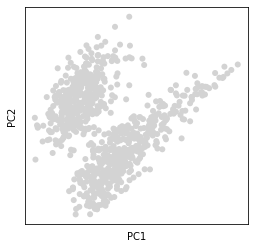

In [29]:
sc.pl.pca(compass_ad)

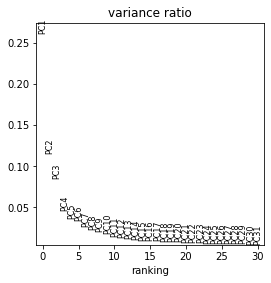

In [30]:
sc.pl.pca_variance_ratio(compass_ad)

In [31]:
sc.tl.leiden(compass_ad, resolution=0.2, key_added="leiden")

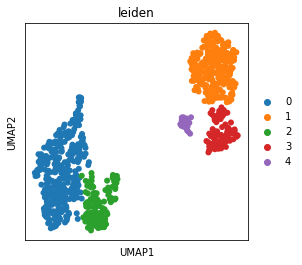

In [32]:
sk.set_figsize((4, 4))
sc.pl.umap(compass_ad,color=['leiden'],ncols=2,wspace=0.5)

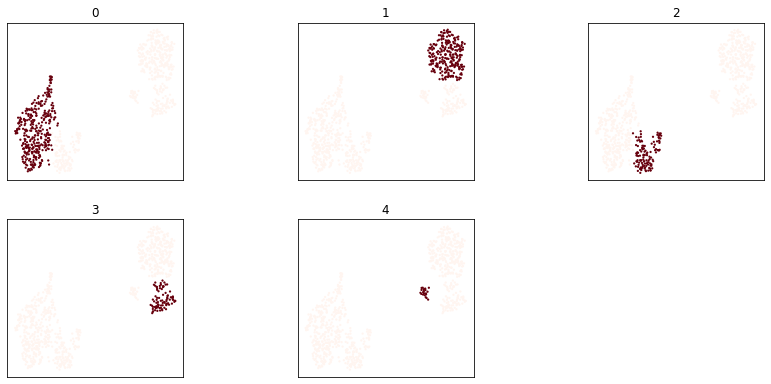

In [33]:
sk.highlight(
    compass_ad, basis="umap", groupby="leiden", wspace=0.5, figsize=(3, 3), size=20, ncols=3
)

In [34]:
sc.tl.rank_genes_groups(compass_ad,
                       groupby='leiden')

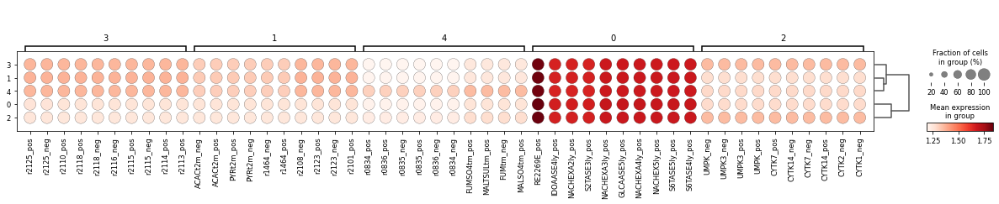

In [35]:
sc.pl.rank_genes_groups_dotplot(compass_ad,
                               n_genes=10)

In [36]:
subsystem_list=[]
for subsystem in compass_ad.var['subsystem'].unique().tolist():
    sc.tl.score_genes(
        compass_ad,
        compass_ad.var.index[compass_ad.var['subsystem']==subsystem].tolist(),
        score_name=subsystem
                 )
    subsystem_list.append(subsystem)

/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will ra

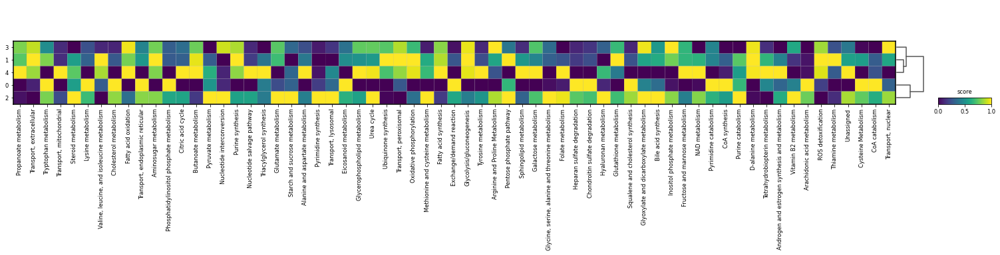

In [37]:
sc.pl.matrixplot(compass_ad,
              var_names=subsystem_list,
              groupby='leiden',
             dendrogram=True,
                colorbar_title='score',
                standard_scale='var')

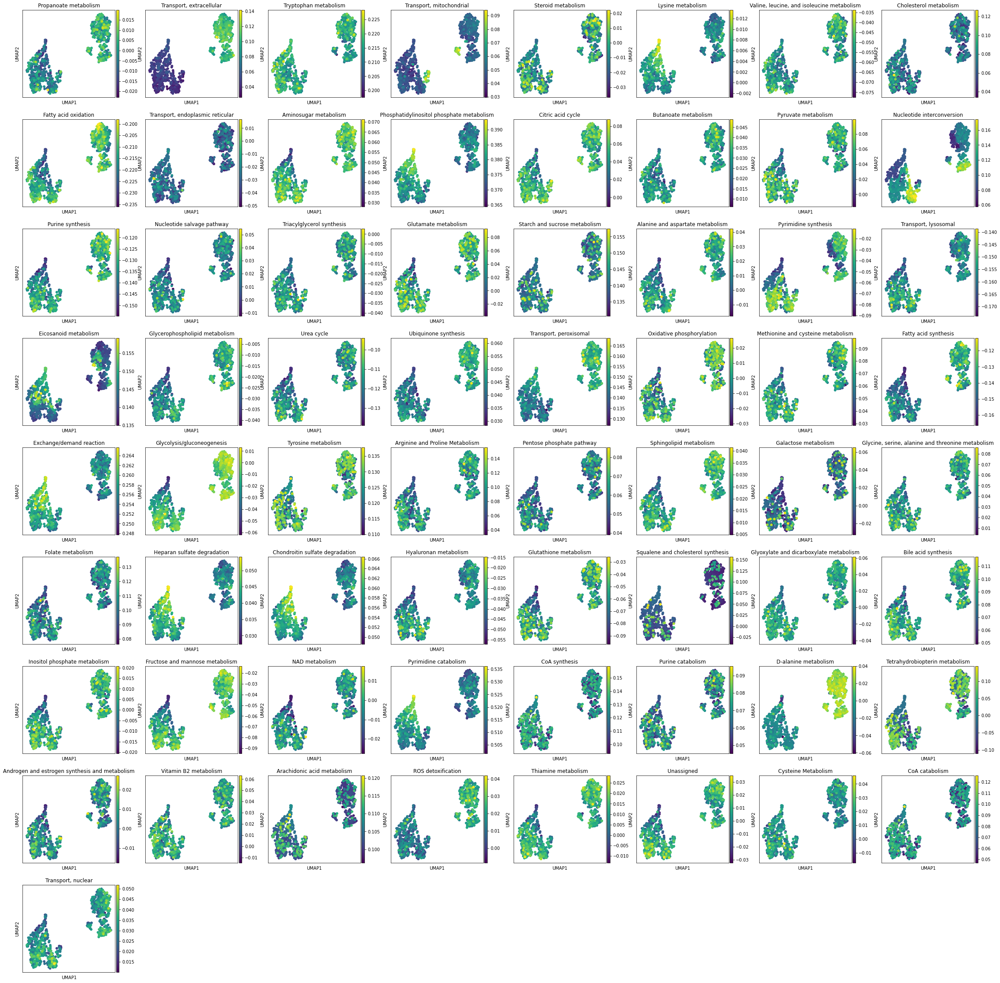

In [38]:
sk.set_figsize((4, 4))
sc.pl.umap(compass_ad, color=subsystem_list,ncols=8)

In [39]:
# Save visium metadata for import
compass_ad.write(f'{path}{run}/compass.anndata.clustered.{today}.h5ad')

In [40]:
#pip install squidpy

In [41]:
import squidpy as sq

import numpy as np

import seaborn as sns

import scanpy as sc

import pandas as pd

import matplotlib.pyplot as plt

import anndata as ad

In [42]:
file=run
vis_path='/nfs/team205/heart/mapped/spaceranger110/'

In [43]:
vis_ad=sq.read.visium(f'{vis_path}{file}')
vis_ad.var_names_make_unique()

/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [44]:
vis_ad.var["mt"] = vis_ad.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(vis_ad, qc_vars=["mt"], inplace=True)

/home/jovyan/my-conda-envs/scanpy/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


<AxesSubplot:xlabel='n_genes_by_counts'>

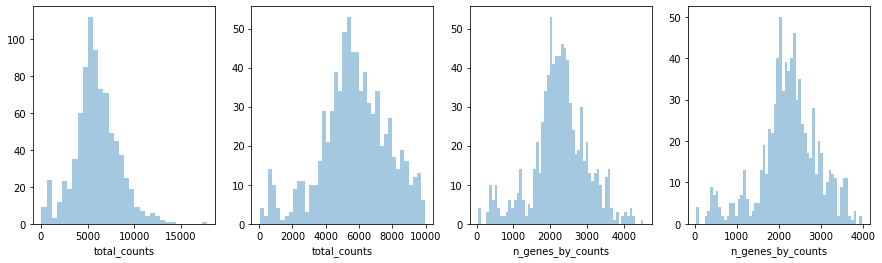

In [45]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.distplot(vis_ad.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(vis_ad.obs["total_counts"][vis_ad.obs["total_counts"] < 10000], kde=False, bins=40, ax=axs[1])
sns.distplot(vis_ad.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.distplot(vis_ad.obs["n_genes_by_counts"][vis_ad.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[3])

In [46]:
vis_ad.X.data[:10]

array([1., 1., 1., 1., 2., 3., 1., 1., 1., 2.], dtype=float32)

In [47]:
sc.pp.normalize_total(vis_ad, inplace=True)
sc.pp.log1p(vis_ad)
vis_ad.raw=vis_ad
sc.pp.highly_variable_genes(vis_ad, flavor="seurat", n_top_genes=2000)

In [48]:
vis_ad.X.data[:10]

array([0.6970526, 0.6970526, 0.6970526, 0.6970526, 1.1038162, 1.3921468, 0.6970526, 0.6970526, 0.6970526, 1.1038162], dtype=float32)

In [49]:
sc.pp.pca(vis_ad)
sc.pp.neighbors(vis_ad)
sc.tl.umap(vis_ad)

In [50]:
sc.tl.leiden(vis_ad,
             resolution=1,
             key_added="cluster")

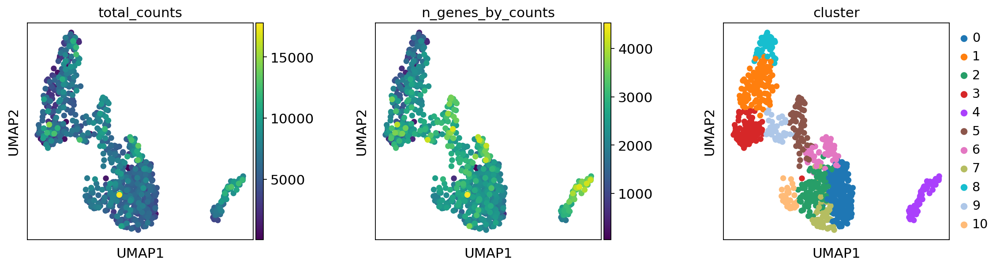

In [51]:
sc.set_figure_params(facecolor="white", figsize=(4, 4))
sc.pl.umap(vis_ad, color=["total_counts", "n_genes_by_counts", "cluster"], wspace=0.4)

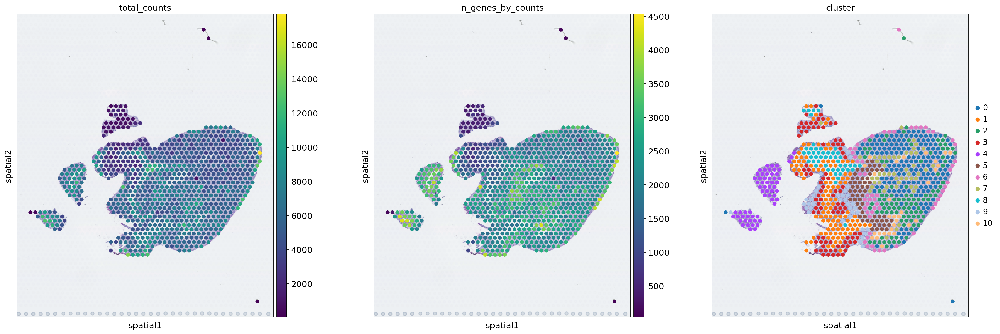

In [52]:
sc.set_figure_params(facecolor="white", figsize=(9, 9))
sc.pl.spatial(vis_ad, img_key="hires", color=["total_counts", "n_genes_by_counts","cluster"],size=1.2)

In [53]:
# Add in compass data
compass_ad.obs.rename(columns = {'leiden':'leiden_compass'}, inplace = True)
compass_ad.obs

,leiden_compass,Propanoate metabolism,"Transport, extracellular",Tryptophan metabolism,"Transport, mitochondrial",Steroid metabolism,Lysine metabolism,"Valine, leucine, and isoleucine metabolism",Cholesterol metabolism,Fatty acid oxidation,...,Tetrahydrobiopterin metabolism,Androgen and estrogen synthesis and metabolism,Vitamin B2 metabolism,Arachidonic acid metabolism,ROS detoxification,Thiamine metabolism,Unassigned,Cysteine Metabolism,CoA catabolism,"Transport, nuclear"
AAACACCAATAACTGC-1,0,-0.001295,0.040879,0.219583,0.039132,0.008968,0.005858,-0.057634,0.080339,-0.210557,...,0.077698,-0.002606,0.040822,0.102794,0.005146,0.002476,0.010136,-0.002799,0.092970,0.025795
AAACCGTTCGTCCAGG-1,0,-0.015498,0.042690,0.216305,0.042346,-0.015399,0.004839,-0.060068,0.076259,-0.223547,...,-0.022904,-0.003238,0.033750,0.104243,0.003649,0.008408,0.001710,0.010236,0.060678,0.026511
AAACTGCTGGCTCCAA-1,3,0.002291,0.083373,0.214385,0.050972,-0.015224,0.002436,-0.051467,0.058670,-0.210652,...,-0.072312,-0.001264,0.039422,0.101361,0.019474,-0.003106,0.003979,0.004506,0.058521,0.030171
AAAGGCTACGGACCAT-1,0,-0.011138,0.041606,0.214319,0.040429,-0.007834,0.005085,-0.053818,0.046747,-0.210088,...,0.055657,0.008736,0.018884,0.102801,0.010751,0.003658,-0.000588,0.013681,0.063920,0.035112
AAAGGCTCTCGCGCCG-1,0,-0.001472,0.042350,0.209558,0.042518,0.009008,0.003580,-0.056177,0.054084,-0.211944,...,0.059129,-0.001491,0.003515,0.101879,0.013167,0.014129,0.005197,0.026739,0.087920,0.027795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTGCAGCCACGTCA-1,3,-0.011681,0.103335,0.210211,0.044052,-0.000279,0.000775,-0.064399,0.070193,-0.211373,...,-0.083545,0.020195,0.004142,0.111486,0.025377,0.014623,-0.018600,0.018516,0.088399,0.032118
TTGTGGTAGGAGGGAT-1,0,-0.007853,0.041913,0.215662,0.049187,-0.009757,0.009254,-0.058203,0.084345,-0.216790,...,-0.034750,0.000917,0.023665,0.102030,-0.004084,0.000522,0.018529,0.021044,0.093866,0.017848
TTGTGTATGCCACCAA-1,2,-0.007046,0.039183,0.214778,0.044047,-0.015237,0.008942,-0.061351,0.073143,-0.225149,...,-0.074881,-0.005398,0.038472,0.103078,0.006790,0.007818,0.007028,0.004873,0.061949,0.034046
TTGTGTTTCCCGAAAG-1,1,-0.007281,0.092928,0.212990,0.046395,-0.008598,0.006118,-0.060557,0.065725,-0.211458,...,0.079089,0.012348,0.027667,0.110597,0.004127,0.025139,-0.005321,0.016364,0.080917,0.033328


In [54]:
vis_ad.obs['leiden_gex']=vis_ad.obs['cluster']
vis_ad.obs

,in_tissue,array_row,array_col,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,cluster,leiden_gex
AAACACCAATAACTGC-1,1,59,19,2487,7.819234,5750.0,8.657129,23.860870,34.226087,45.008696,59.600000,178.0,5.187386,3.095652,4,4
AAACCGTTCGTCCAGG-1,1,52,42,2314,7.747165,4884.0,8.493924,23.300573,34.111384,45.249795,59.930385,212.0,5.361292,4.340704,9,9
AAACTGCTGGCTCCAA-1,1,45,67,3516,8.165364,9304.0,9.138308,21.302666,33.351247,44.475494,57.598882,307.0,5.730100,3.299656,5,5
AAAGGCTACGGACCAT-1,1,62,54,2068,7.634821,8427.0,9.039315,56.354575,63.249080,70.511451,79.779281,304.0,5.720312,3.607452,1,1
AAAGGCTCTCGCGCCG-1,1,55,55,2566,7.850493,6544.0,8.786457,27.933985,36.827628,47.784230,62.606968,309.0,5.736572,4.721882,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTGCAGCCACGTCA-1,1,60,74,2033,7.617760,6687.0,8.808070,46.104382,55.510692,64.573052,75.519665,269.0,5.598422,4.022730,10,10
TTGTGGTAGGAGGGAT-1,1,50,28,3382,8.126518,8234.0,9.016149,20.318193,30.434783,41.049308,55.343697,210.0,5.351858,2.550401,4,4
TTGTGTATGCCACCAA-1,1,56,60,2508,7.827640,5534.0,8.618847,22.985183,33.303216,44.362125,58.800145,260.0,5.564520,4.698229,9,9
TTGTGTTTCCCGAAAG-1,1,51,59,3344,8.115222,7476.0,8.919587,18.472445,26.431247,36.503478,51.899411,200.0,5.303305,2.675227,9,9


In [55]:
vis_ad.obs=vis_ad.obs.join(compass_ad.obs) # replace adata.obs by a concatenation which now includes compass reactions and leiden

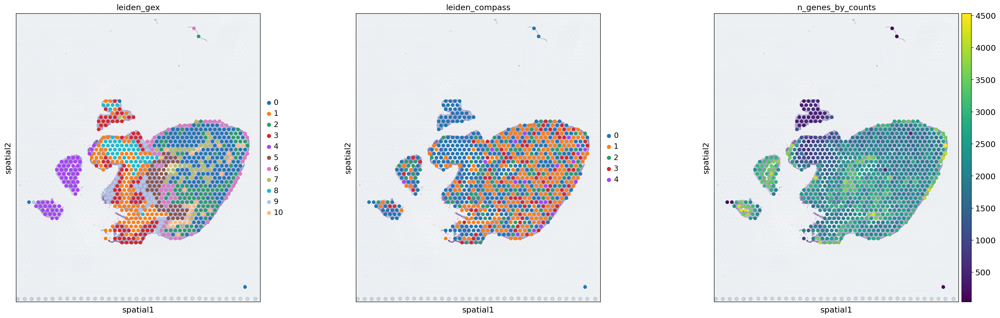

In [56]:
sc.set_figure_params(facecolor="white", figsize=(9, 9))
sc.pl.spatial(vis_ad, img_key="hires", color=["leiden_gex", "leiden_compass",'n_genes_by_counts'],size=1.2)

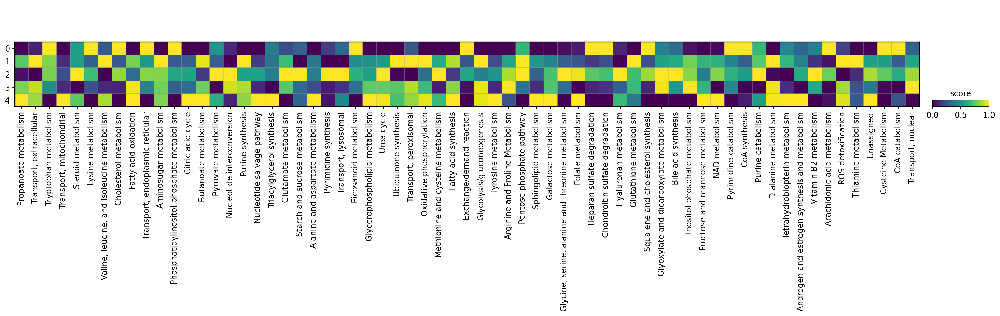

In [57]:
sc.pl.matrixplot(compass_ad,
              var_names=subsystem_list,
              groupby='leiden_compass',
                colorbar_title='score',
                standard_scale='var')

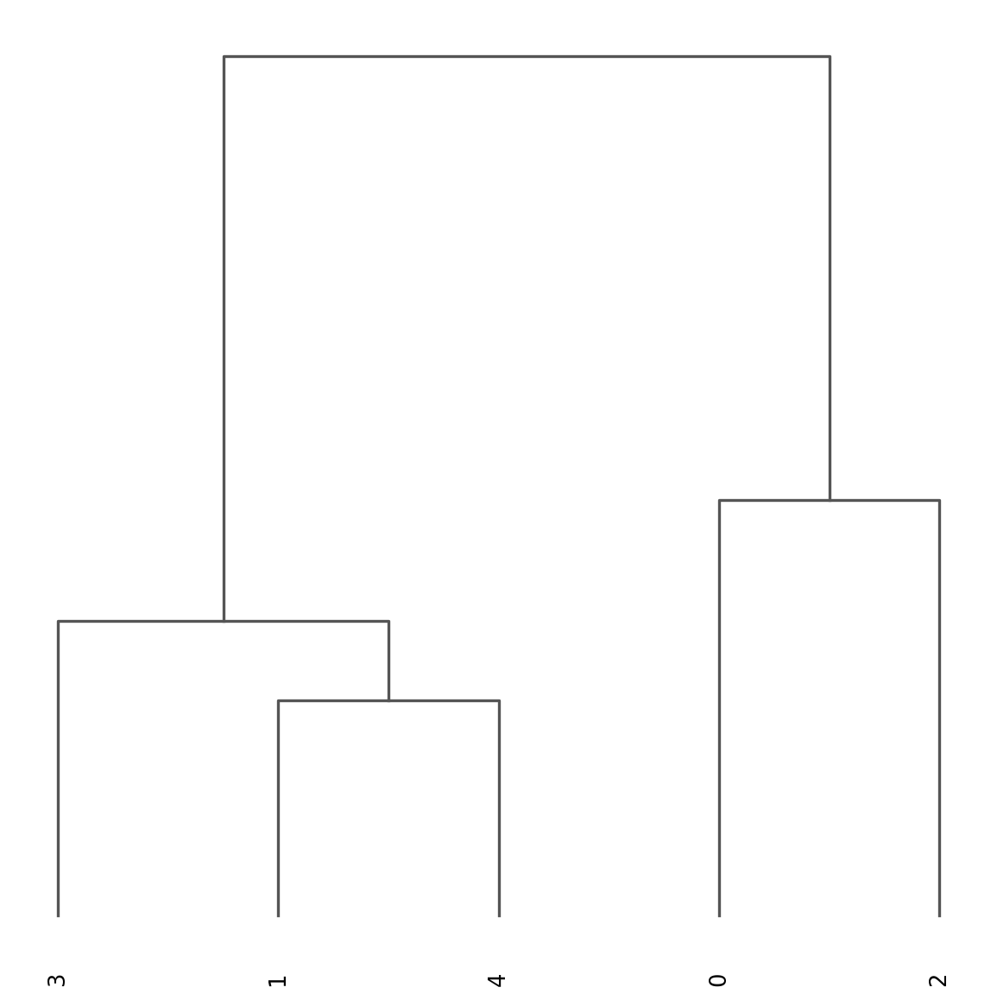

<AxesSubplot:>

In [58]:
sc.tl.dendrogram(compass_ad, groupby='leiden_compass')
sc.pl.dendrogram(compass_ad, groupby='leiden_compass')

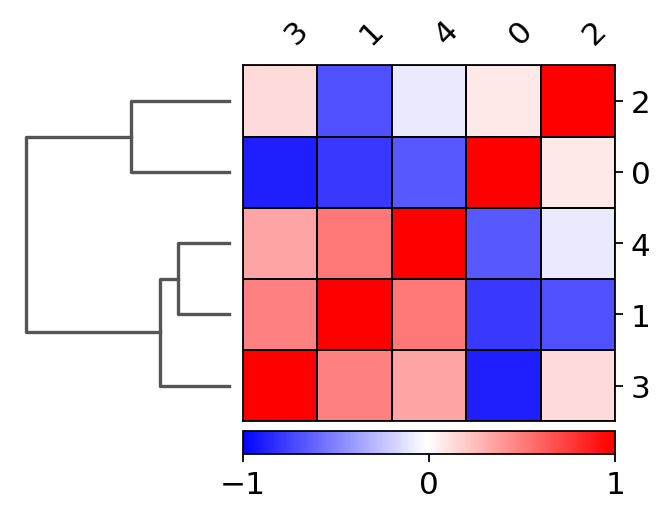

In [59]:
sc.pl.correlation_matrix(compass_ad, groupby='leiden_compass')

In [60]:
# Merge highly correlated groups

old_to_new = {
    '0':'Eicosanoid metabolism',
    '1':'FA oxidation; Glycolysis',
    '2':'Pyruvate metabolism',
    '3':'FA oxidation; Glycolysis',
    '4':'FA oxidation; Glycolysis'
}
vis_ad.obs['leiden_compass_merged'] = (
    vis_ad.obs['leiden_compass']
    .map(old_to_new)
    .astype('category')
)

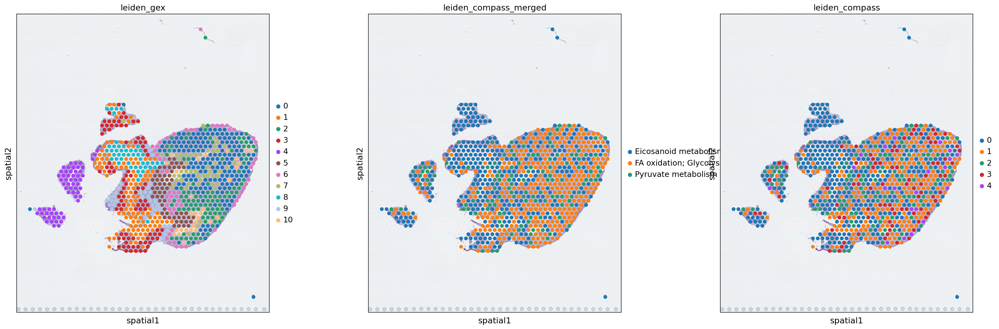

In [61]:
sc.set_figure_params(facecolor="white", figsize=(9, 9))
sc.pl.spatial(vis_ad, img_key="hires", color=["leiden_gex", 'leiden_compass_merged',"leiden_compass"],size=1.2)

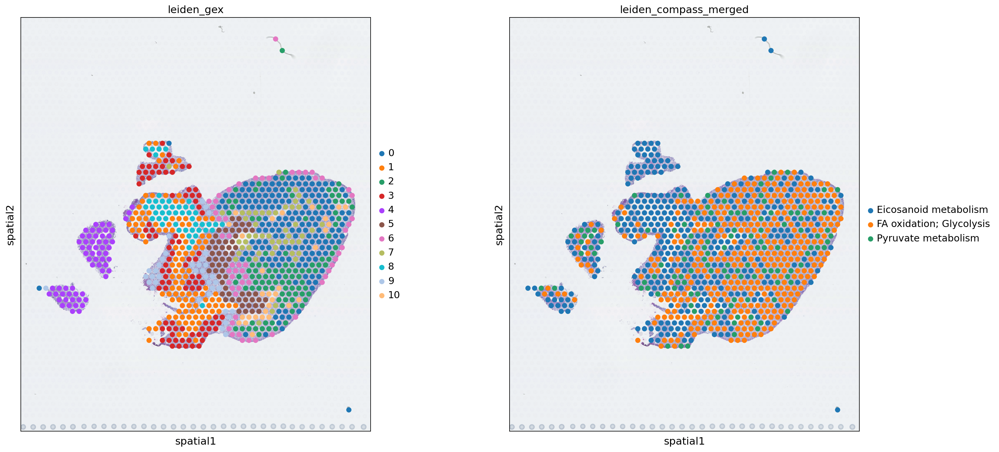

In [62]:
sc.set_figure_params(facecolor="white", figsize=(10,10))
sc.pl.spatial(vis_ad, img_key="hires", color=["leiden_gex", 'leiden_compass_merged'],size=1.2)

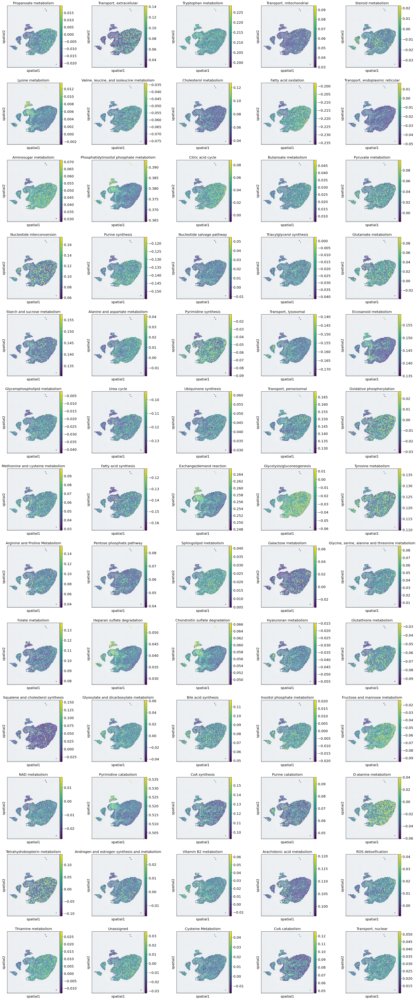

In [63]:
sc.set_figure_params(facecolor="white", figsize=(5, 5))
sc.pl.spatial(vis_ad, img_key="hires", color=subsystem_list,size=1.2,ncols=5)